In [ ]:
!pip install opencv-python-headless

In [ ]:
#for machine learning models
!pip install tensorflow

In [ ]:
#micro web framework for setting up a simple web server.
!pip install flask

In [ ]:
!pip install pandas

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
from pathlib import Path

In [ ]:

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
project_folder = '/content/drive/MyDrive/KPDL/image'

In [ ]:
import os
# Đường dẫn tuyệt đối của thư mục dự án mới
# Thay đổi thư mục làm việc
os.chdir(project_folder)

# Xác nhận thư mục làm việc mới
print("Thư mục làm việc hiện tại:", os.getcwd())

# Liệt kê tất cả các tập tin và thư mục trong thư mục làm việc mới
print("Danh sách các tập tin và thư mục:")
print(os.listdir('.'))

Thư mục làm việc hiện tại: /content/drive/MyDrive/KPDL/image
Danh sách các tập tin và thư mục:
['coco.names', 'yolov3.cfg', '2.png', '4.png', '6.png', '9.png', '10.png', '11.png', '13.png', '17.png', '18.png', '20.png', '21.png', '23.png', '24.png', '27.png', '28.png', '29.png', '30.png', '32.png', '1.png', '3.png', '5.png', '7.png', '8.png', '15.png', '12.png', '16.png', '14.png', '22.png', '19.png', '25.png', '26.png', '31.png', 'yolov3.weights', 'yolov9', 'weights']


2.png
4.png
3.png
5.png
1.png
6.png
18.png
13.png
14.png
12.png
15.png
10.png
17.png
8.png
9.png
16.png
11.png
7.png
22.png
31.png
25.png
23.png
24.png
28.png
20.png
30.png
29.png
19.png
27.png
21.png
26.png
32.png


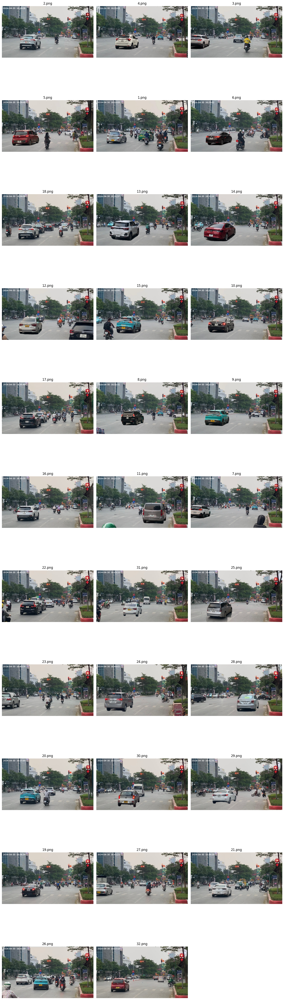

In [ ]:
image_paths = ('2.png', '4.png', '3.png', '5.png', '1.png', '6.png', '18.png', '13.png', '14.png', '12.png', '15.png', '10.png', '17.png', '8.png', '9.png', '16.png', '11.png', '7.png', '22.png', '31.png', '25.png', '23.png', '24.png', '28.png', '20.png', '30.png', '29.png', '19.png', '27.png', '21.png', '26.png', '32.png')
#set up 3 images per row
num_rows = len(image_paths) // 3 + (1 if len(image_paths) % 3 else 0)
plt.figure(figsize=(15, 5 * num_rows))
#print images
for index, path in enumerate(image_paths):
    print(path)
    image = cv2.imread(path)
    #check if the image was loaded successfully
    if image is not None:
        plt.subplot(num_rows, 3, index + 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        #print name of image
        plt.title(path.split('/')[-1])
        plt.axis('off')
    else:
        print(f"Failed to load image at path: {path}")
#set layout
plt.tight_layout()
plt.show()

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from skimage.filters import sobel
!pip install tensorflow

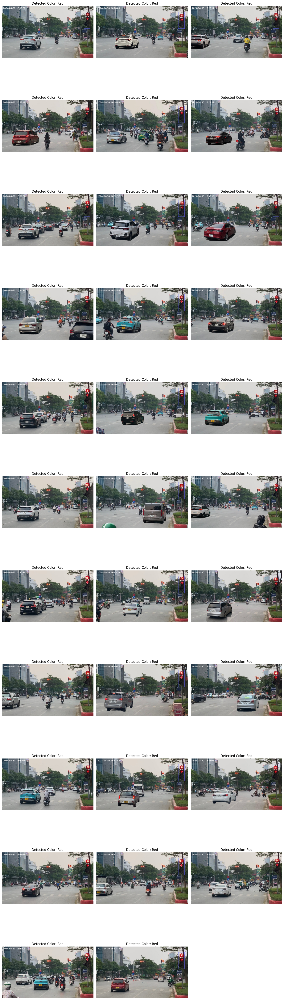

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def detect_traffic_light_color(image, rect):
    # Unpack the rectangle coordinates
    x, y, w, h = rect

    # Crop the region of interest (ROI) from the image
    roi = image[y:y+h, x:x+w]

    # Convert the ROI to HSV color space
    hsv = cv2.cvtColor(roi, cv2.COLOR_BGR2HSV)

    # Define ranges for red, green, and yellow colors in HSV
    # Note: These ranges might need adjustment depending on your specific images
    lower_red = np.array([100, 130, 130])
    upper_red = np.array([200, 350, 350])
    lower_green = np.array([240, 150, 150])
    upper_green = np.array([300, 350, 350])

    # Create masks for colors
    mask_red = cv2.inRange(hsv, lower_red, upper_red)
    mask_green = cv2.inRange(hsv, lower_green, upper_green)

    # Calculate the percentage of pixel within the mask for each color
    red_ratio = np.sum(mask_red) / (w * h)
    green_ratio = np.sum(mask_green) / (w * h)

    # Determine the most dominant color in the ROI
    if red_ratio > green_ratio:
        detected_color = "Red"
    elif green_ratio > red_ratio:
        detected_color = "Green"
    else:
        detected_color = "Unknown"

    # For visualization, draw a rectangle around the ROI in the original image
    cv2.rectangle(image, (x, y), (x+w, y+h), (255, 100, 100), 2)

    return image, detected_color


# Set up 3 images per row
num_rows = len(image_paths) // 3 + (1 if len(image_paths) % 3 else 0)
plt.figure(figsize=(15, 5 * num_rows))

# Iterate through image paths
for index, path in enumerate(image_paths):
    image = cv2.imread(path)

    if image is None:
        print("Không thể tải hình ảnh từ", path)
    else:
        rect = (1720, 120, 130, 350)  # Example rectangle coordinates
        processed_image, detected_color = detect_traffic_light_color(image, rect)

        plt.subplot(num_rows, 3, index + 1)
        plt.imshow(cv2.cvtColor(processed_image, cv2.COLOR_BGR2RGB))
        plt.title(f"Detected Color: {detected_color}")
        plt.axis('off')

# Set layout
plt.tight_layout()
plt.show()

**YOLOV9**

In [ ]:
!nvidia-smi

/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content/drive/MyDrive/KPDL/image


In [ ]:
!git clone https://github.com/SkalskiP/yolov9.git
%cd yolov9
!pip install -r requirements.txt -q

fatal: destination path 'yolov9' already exists and is not an empty directory.
/content/drive/MyDrive/KPDL/image/yolov9


In [ ]:
!pip install -q roboflow

In [ ]:
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/yolov9-e.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-c.pt
!wget -P {HOME}/weights -q https://github.com/WongKinYiu/yolov9/releases/download/v0.1/gelan-e.pt

In [ ]:
!python detect.py --weights {HOME}/weights/gelan-c.pt --conf 0.1 --source image_paths --device 0

Traceback (most recent call last):
  File "/content/drive/MyDrive/KPDL/image/yolov9/detect.py", line 15, in <module>
    from models.common import DetectMultiBackend
  File "/content/drive/MyDrive/KPDL/image/yolov9/models/common.py", line 30, in <module>
    from utils.plots import Annotator, colors, save_one_box
  File "/content/drive/MyDrive/KPDL/image/yolov9/utils/plots.py", line 13, in <module>
    import seaborn as sn
  File "/usr/local/lib/python3.10/dist-packages/seaborn/__init__.py", line 5, in <module>
    from .relational import *  # noqa: F401,F403
  File "/usr/local/lib/python3.10/dist-packages/seaborn/relational.py", line 20, in <module>
    from ._statistics import EstimateAggregator, WeightedAggregator
  File "<frozen importlib._bootstrap>", line 1027, in _find_and_load
  File "<frozen importlib._bootstrap>", line 1006, in _find_and_load_unlocked
  File "<frozen importlib._bootstrap>", line 688, in _load_unlocked
  File "<frozen importlib._bootstrap_external>", line 879,

**END YOLOV9**

**YOLOV3 detect traffic light**

In [ ]:
pip install requests

ERROR: Operation cancelled by user


In [ ]:
import requests

def download_file(url, filename):
    # Gửi một HTTP GET request đến URL
    response = requests.get(url)
    # Mở một tệp nhị phân mới để ghi
    with open(filename, 'wb') as f:
        f.write(response.content)

# URLs của tệp weights, cfg và names
url_weights = 'https://pjreddie.com/media/files/yolov3.weights'
url_cfg = 'https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg'
url_names = 'https://raw.githubusercontent.com/pjreddie/darknet/master/data/coco.names'

# Tải các tệp xuống
download_file(url_weights, 'yolov3.weights')
download_file(url_cfg, 'yolov3.cfg')
download_file(url_names, 'coco.names')


In [ ]:
pip install opencv-python-headless


In [ ]:
import cv2
import numpy as np

# Định nghĩa các hàm cần thiết
def load_yolo():
    # Đường dẫn tới tệp cấu hình và trọng số YOLO
    weightsPath = "yolov3.weights"
    configPath = "yolov3.cfg"
    labelsPath = "coco.names"

    # Tải trọng số và cấu hình để tạo mô hình
    net = cv2.dnn.readNetFromDarknet(configPath, weightsPath)

    # Tải tên các lớp
    with open(labelsPath, "r") as f:
        classes = [line.strip() for line in f.readlines()]

    return net, classes


def detect_objects(img, net, output_layers):
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)
    net.setInput(blob)
    outputs = net.forward(output_layers)
    return outputs

def get_boxes(outputs, height, width, conf_threshold=0.5):
    boxes = []
    confidences = []
    class_ids = []

    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]

            if confidence > conf_threshold:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)

                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)

    return boxes, confidences, class_ids

def analyze_traffic_light_color(img, box):
    x, y, w, h = box
    traffic_light_img = img[y:y+h, x:x+w]
    hsv_img = cv2.cvtColor(traffic_light_img, cv2.COLOR_BGR2HSV)

    # Định nghĩa các khoảng màu HSV
    red1_lower = np.array([0, 70, 50])
    red1_upper = np.array([10, 255, 255])
    red2_lower = np.array([170, 70, 50])
    red2_upper = np.array([180, 255, 255])
    green_lower = np.array([50, 70, 50])
    green_upper = np.array([90, 255, 255])
    yellow_lower = np.array([20, 100, 100])
    yellow_upper = np.array([30, 255, 255])

    # Tạo mask cho mỗi màu
    red_mask1 = cv2.inRange(hsv_img, red1_lower, red1_upper)
    red_mask2 = cv2.inRange(hsv_img, red2_lower, red2_upper)
    red_mask = cv2.bitwise_or(red_mask1, red_mask2)
    green_mask = cv2.inRange(hsv_img, green_lower, green_upper)
    yellow_mask = cv2.inRange(hsv_img, yellow_lower, yellow_upper)

    # Tính tổng diện tích phát hiện màu sắc
    if np.sum(red_mask) > np.sum(green_mask) and np.sum(red_mask) > np.sum(yellow_mask):
        return "Red"
    elif np.sum(green_mask) > np.sum(red_mask) and np.sum(green_mask) > np.sum(yellow_mask):
        return "Green"
    elif np.sum(yellow_mask) > np.sum(red_mask) and np.sum(yellow_mask) > np.sum(green_mask):
        return "Yellow"
    else:
        return "Unknown"


def process_image(img_path):
    model, classes = load_yolo()
    image = cv2.imread(img_path)
    if image is None:
        print(f"Failed to load image: {img_path}")
        return None
    height, width, channels = image.shape
    layer_names = model.getLayerNames()
    output_layers = [layer_names[i - 1] for i in model.getUnconnectedOutLayers().flatten()]
    outputs = detect_objects(image, model, output_layers)
    boxes, confidences, class_ids = get_boxes(outputs, height, width)
    color_detected = draw_labels(boxes, confidences, class_ids, classes, image)
    return color_detected

def draw_labels(boxes, confidences, class_ids, classes, img):
    traffic_light_color = None
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    for i in indexes.flatten():
        x, y, w, h = boxes[i]
        label = str(classes[class_ids[i]])
        if label == "traffic light":
            color = analyze_traffic_light_color(img, (x, y, w, h))
            if color in ["Red", "Green", "Yellow"]:
                traffic_light_color = color
    return traffic_light_color



# Chạy phân tích cho mỗi ảnh
for img_path in image_paths:
    color = process_image(img_path)
    if color:
        traffic_light_colors[img_path] = color
    else:
        traffic_light_colors[img_path] = "No traffic light detected"

# In ra kết quả
for img_path, color in traffic_light_colors.items():
    print(f"{img_path}: {color}")




**Creat stopline**

In [ ]:
pip install labelImg


In [ ]:
import cv2
import matplotlib.pyplot as plt

def draw_line(image_path, start_point, end_point, color=(255, 0, 0), thickness=3):
    # Đọc ảnh
    image = cv2.imread(image_path)
    if image is None:
        print("Failed to load image at", image_path)
        return

    # Vẽ đường thẳng
    cv2.line(image, start_point, end_point, color, thickness)

    # Hiển thị ảnh
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title('Image with Line')
    plt.show()

    # Lưu ảnh nếu muốn
    # cv2.imwrite('path_to_save_image.jpg', image)

# Các tham số mẫu cho hàm draw_line

start_point = (0, 820)  # Điểm bắt đầu của đường thẳng
end_point = (1610, 900)  # Điểm kết thúc của đường thẳng

for image_path in image_paths:
    draw_line(image_path, start_point, end_point, color=(0, 255, 0), thickness=6)



**YOLOV3 detect car**

In [ ]:
pip install opencv-python-headless matplotlib

In [ ]:
from google.colab.patches import cv2_imshow


In [ ]:
confidence_threshold = 0.3  # Lower it from 0.5 to 0.3
nms_threshold = 0.4  # Adjust this based on your specific needs

In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Import cv2_imshow for Google Colab

def load_yolo():
    net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")
    classes = []
    with open("coco.names", "r") as f:
        classes = [line.strip() for line in f.readlines()]
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers().flatten()]
    return net, classes, output_layers

def detect_objects(img, net, output_layers):
    height, width, _ = img.shape
    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), swapRB=True, crop=False)
    net.setInput(blob)
    outputs = net.forward(output_layers)
    boxes = []
    confidences = []
    class_ids = []
    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)
    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    return boxes, indexes, class_ids, confidences

def draw_labels(boxes, indexes, class_ids, classes, img):
    if len(indexes) > 0:
        indexes = indexes.flatten()  # Ensure 'indexes' is a flat array
    for i in indexes:
        box = boxes[i]
        x, y, w, h = box
        label = str(classes[class_ids[i]])
        color = (0, 255, 0)  # Color for the bounding box
        cv2.rectangle(img, (x, y), (x + w, y + h), color, 2)
        cv2.putText(img, label, (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)
    return img

# Load YOLO
net, classes, output_layers = load_yolo()


# Load and process each image
for image_path in image_paths:
    image = cv2.imread(image_path)
    if image is None:
        print("Image not found:", image_path)
        continue
    height, width, _ = image.shape
    outputs = detect_objects(image, net, output_layers)
    boxes, indexes, class_ids, confidences = get_box_dimensions(outputs, height, width)
    image = draw_labels(boxes, indexes, class_ids, classes, image)
    cv2_imshow(image)  # Display the image with detections

    # Print detection details
    print("Detections:", len(indexes))
    for i in indexes:
        box = boxes[i]
        print(f"Box {i}: {box}, Class: {classes[class_ids[i]]}, Confidence: {confidences[i]:.2f}")


In [ ]:
def get_box_dimensions(outputs, height, width, conf_threshold=0.3):  # Adjusted confidence threshold
    boxes = []
    confs = []
    class_ids = []
    for output in outputs:
        for detect in output:
            scores = detect[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > conf_threshold:
                center_x = int(detect[0] * width)
                center_y = int(detect[1] * height)
                w = int(detect[2] * width)
                h = int(detect[3] * height)
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confs.append(float(confidence))
                class_ids.append(class_id)
    return boxes, confs, class_ids

# Now adjust the NMS threshold in the draw_labels function
def draw_labels(boxes, confs, colors, class_ids, classes, image, nms_threshold=0.4):  # Adjusted NMS threshold
    indexes = cv2.dnn.NMSBoxes(boxes, confs, conf_threshold, nms_threshold)
    for i in indexes:
        i = i[0]
        box = boxes[i]
        x, y, w, h = box
        label = str(classes[class_ids[i]])
        color = colors[class_ids[i]]
        cv2.rectangle(image, (x, y), (x + w, y + h), color, 2)
        cv2.putText(image, label, (x, y + 30), cv2.FONT_HERSHEY_PLAIN, 1, color, 2)
    return image


In [ ]:
import cv2
import numpy as np
from google.colab.patches import cv2_imshow  # Import cv2_imshow

def load_yolo():
    net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")
    classes = []
    with open("coco.names", "r") as f:
        classes = [line.strip() for line in f.readlines()]
    layer_names = net.getLayerNames()
    # Flatten the layer indices to handle them as a simple list
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers().flatten()]
    return net, classes, output_layers

def detect_objects(image, net, output_layers):
    blob = cv2.dnn.blobFromImage(image, scalefactor=0.00392, size=(416, 416), mean=(0, 0, 0), swapRB=True, crop=False)
    net.setInput(blob)
    outputs = net.forward(output_layers)
    return outputs

def get_box_dimensions(outputs, height, width):
    boxes = []
    confs = []
    class_ids = []
    for output in outputs:
        for detect in output:
            scores = detect[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detect[0] * width)
                center_y = int(detect[1] * height)
                w = int(detect[2] * width)
                h = int(detect[3] * height)
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                boxes.append([x, y, w, h])
                confs.append(float(confidence))
                class_ids.append(class_id)
    return boxes, confs, class_ids

def draw_labels(boxes, confs, colors, class_ids, classes, image):
    indexes = cv2.dnn.NMSBoxes(boxes, confs, 0.5, 0.4)
    for i in indexes:
        i = i[0]
        box = boxes[i]
        x, y, w, h = box
        label = str(classes[class_ids[i]])
        color = colors[class_ids[i]]
        cv2.rectangle(image, (x, y), (x + w, y + h), color, 2)
        cv2.putText(image, label, (x, y + 30), cv2.FONT_HERSHEY_PLAIN, 1, color, 2)
    return image

# Load YOLO
net, classes, output_layers = load_yolo()
colors = np.random.uniform(0, 255, size=(len(classes), 3))

for image_path in image_paths:
    image = cv2.imread(image_path)
    if image is None:
        print("Image not found:", image_path)
        continue
    height, width, _ = image.shape
    outputs = detect_objects(image, net, output_layers)
    boxes, confs, class_ids = get_box_dimensions(outputs, height, width)
    image = draw_labels(boxes, confs, colors, class_ids, classes, image)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))  # Convert BGR to RGB
    plt.axis('off')  # Hide axis
    plt.show()

In [ ]:
def extract_license_plate(frame, mask_line):
    # Convert the image to grayscale (Haar cascades are typically trained on grayscale images)
    gray = cv2.cvtColor(mask_line, cv2.COLOR_BGR2GRAY)

    # Apply CLAHE to equalize the histogram
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    gray = clahe.apply(gray)

    # Erode the image using a 2x2 kernel to remove noise
    kernel = np.ones((2, 2), np.uint8)
    gray = cv2.erode(gray, kernel, iterations=1)

    # Find the bounding box of non-black pixels
    non_black_points = cv2.findNonZero(gray)
    x, y, w, h = cv2.boundingRect(non_black_points)

    # Calculate the new width of the bounding box, excluding 30% on the right side
    w = int(w * 0.7)

    # Crop the image to the bounding box
    cropped_gray = gray[y:y+h, x:x+w]

    # Detect license plates in the image (this returns a list of rectangles)
    license_plates = license_plate_cascade.detectMultiScale(cropped_gray, scaleFactor=1.07, minNeighbors=15, minSize=(20, 20))

    # List to hold cropped license plate images
    license_plate_images = []

    # Loop over the license plates
    for (x_plate, y_plate, w_plate, h_plate) in license_plates:
        # Draw a rectangle around the license plate in the original frame (here you need the original coordinates)
        cv2.rectangle(frame, (x_plate + x, y_plate + y), (x_plate + x + w_plate, y_plate + y + h_plate), (0, 255, 0), 3)

        # Crop the license plate and append it to the list (here x_plate and y_plate are relative to cropped_gray)
        license_plate_image = cropped_gray[y_plate:y_plate+h_plate, x_plate:x_plate+w_plate]
        license_plate_images.append(license_plate_image)

    return frame, license_plate_images

In [ ]:
def apply_ocr_to_image(license_plate_image):
    # Threshold the image
    _, img = cv2.threshold(license_plate_image, 120, 255, cv2.THRESH_BINARY)

    # Convert OpenCV image format to PIL Image format for pytesseract
    pil_img = Image.fromarray(img)

    # Use pytesseract to extract text from the image
    full_text = pytesseract.image_to_string(pil_img, config='--psm 6')

    return full_text.strip()  # Removing any extra white spaces from the ends

In [ ]:
def draw_penalized_text(frame):
    # Set font, scale, thickness, and color
    font = cv2.FONT_HERSHEY_TRIPLEX
    font_scale = 1
    font_thickness = 2
    color = (255, 255, 255)  # White color

    # Initial position for Y-coordinate
    y_pos = 180

    # Put title on the frame
    cv2.putText(frame, 'Fined license plates:', (25, y_pos), font, font_scale, color, font_thickness)

    # Update Y-coordinate position
    y_pos += 80

    # Loop through all fined license plates
    for text in penalized_texts:
        # Add fined license plate text on the frame
        cv2.putText(frame, '->  '+text, (40, y_pos), font, font_scale, color, font_thickness)

        # Update Y-coordinate for next license plate
        y_pos += 60

In [ ]:
def create_database_and_table(host, user, password, database):
    try:
        # Create a connection
        connection = mysql.connector.connect(
            host = host,
            user = user,
            password = password
        )

        if connection.is_connected():
            # Create a new database cursor
            cursor = connection.cursor()

            # Create a new database using the provided name
            cursor.execute(f"CREATE DATABASE IF NOT EXISTS {database}")
            print(f"Database {database} created successfully!")

            # Use the newly created database
            cursor.execute(f"USE {database}")

            # Create a new table
            cursor.execute("""
                CREATE TABLE IF NOT EXISTS license_plates (
                    id INT AUTO_INCREMENT PRIMARY KEY,
                    plate_number VARCHAR(255) NOT NULL UNIQUE,
                    violation_count INT DEFAULT 1
                )
            """)
            print("Table created successfully!")

            cursor.close()

    except Error as e:
        print("Error while connecting to MySQL", e)

    finally:
        if connection.is_connected():
            connection.close()

In [ ]:
def update_database_with_violation(plate_number, host, user, password, database):
    try:
        connection = mysql.connector.connect(
            host = host,
            user = user,
            password = password,
            database = database
        )

        if connection.is_connected():
            cursor = connection.cursor()

            # Check if the license plate already exists in the table
            cursor.execute(f"SELECT violation_count FROM license_plates WHERE plate_number='{plate_number}'")
            result = cursor.fetchone()

            if result:
                # Increment violation_count by 1 if plate_number already exists
                cursor.execute(f"UPDATE license_plates SET violation_count=violation_count+1 WHERE plate_number='{plate_number}'")
            else:
                # Insert a new record if plate_number doesn't exist
                cursor.execute(f"INSERT INTO license_plates (plate_number) VALUES ('{plate_number}')")

            connection.commit()
            cursor.close()

    except Error as e:
        print("Error while connecting to MySQL", e)

    finally:
        if connection.is_connected():
            connection.close()

In [ ]:
def print_all_violations(host, user, password, database):
    try:
        connection = mysql.connector.connect(
            host = host,
            user = user,
            password = password,
            database = database
        )

        if connection.is_connected():
            cursor = connection.cursor()

            # Fetch all violations from the database
            cursor.execute("SELECT plate_number, violation_count FROM license_plates ORDER BY violation_count DESC")
            result = cursor.fetchall()

            print("\n")
            print("-"*66)
            print("\nAll Registered Traffic Violations in the Database:\n")
            for record in result:
                print(f"Plate Number: {record[0]}, Violations: {record[1]}")

            cursor.close()

    except Error as e:
        print("Error while connecting to MySQL", e)

    finally:
        if connection.is_connected():
            connection.close()

In [ ]:
def clear_license_plates(host, user, password, database):
    try:
        connection = mysql.connector.connect(
            host = host,
            user = user,
            password = password,
            database = database
        )

        if connection.is_connected():
            cursor = connection.cursor()

            # Delete all records from the table
            cursor.execute("DELETE FROM license_plates")

            connection.commit()
            cursor.close()

    except Error as e:
        print("Error while connecting to MySQL", e)

    finally:
        if connection.is_connected():
            connection.close()

In [ ]:
def main():
    # Ensure the database and table exist
    # create_database_and_table(DB_HOST, DB_USER, DB_PASSWORD, DB_NAME)

    # Clear the license plates from the previous run. (Comment out this line if desired!)
    # clear_license_plates(DB_HOST, DB_USER, DB_PASSWORD, DB_NAME)

    # Open the video file
    vid = cv2.VideoCapture('/kaggle/input/license-plate-recognition-for-red-light-violation/traffic_video_modified.mp4')

    # Create detector object
    detector = LineDetector()

    # Loop through each frame in the video
    while True:
        # Read frame
        ret, frame = vid.read()

        # Break if frame is not returned
        if not ret:
            break

        # Assuming rect is the rectangle where the traffic light is located
        rect = (1700, 40, 100, 250)

        # Detect traffic light color
        frame, color = detect_traffic_light_color(frame, rect)

        # Detect white line
        frame, mask_line = detector.detect_white_line(frame, color)

        # Process the frame if the light is red
        if color == 'red':
            # Extract license plate
            frame, license_plate_images = extract_license_plate(frame, mask_line)

            # Process each detected license plate
            for license_plate_image in license_plate_images:
                # Apply OCR to the license plate image
                text = apply_ocr_to_image(license_plate_image)

                # Add the detected license plate to the list if it matches the pattern and is not already in the list
                if text is not None and re.match("^[A-Z]{2}\s[0-9]{3,4}$", text) and text not in penalized_texts:
                    penalized_texts.append(text)
                    print(f"\nFined license plate: {text}")

                    # Plot the license plate image
                    plt.figure()
                    plt.imshow(license_plate_image, cmap='gray')
                    plt.axis('off')
                    plt.show()

                    # Update the database with the license plate violation
                    # update_database_with_violation(text, DB_HOST, DB_USER, DB_PASSWORD, DB_NAME)

        # Draw the penalized text onto the frame if there is any
        if penalized_texts:
            draw_penalized_text(frame)

        # Display the frame
        # cv2_imshow('frame', frame)
        cv2_imshow(frame)

        # Break if ESC key is pressed (uncomment the following line when running on a local system with GUI support)
        if cv2.waitKey(1) == 27:
            break

    # Release the video
    vid.release()

    # Close all OpenCV windows (uncomment the following line when running on a local system with GUI support)
    cv2.destroyAllWindows()

    # Print all the violations from the database
    # print_all_violations(DB_HOST, DB_USER, DB_PASSWORD, DB_NAME)

In [ ]:
%%capture
# Download the trained Haar Cascade from the GitHub repository
url = "https://raw.githubusercontent.com/FarzadNekouee/Traffic-Violation-Detection/master/haarcascade_russian_plate_number.xml"
response = requests.get(url)

with open('haarcascade_russian_plate_number.xml', 'wb') as file:
    file.write(response.content)

# Load the trained Haar Cascade
license_plate_cascade = cv2.CascadeClassifier('haarcascade_russian_plate_number.xml')

# Create a list to store unique penalized license plate texts
penalized_texts = []

**EXTRACT TIME**

In [ ]:
from google.colab.patches import cv2_imshow

In [ ]:
!pip install pytesseract

In [ ]:
!sudo apt install tesseract-ocr

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  tesseract-ocr-eng tesseract-ocr-osd
The following NEW packages will be installed:
  tesseract-ocr tesseract-ocr-eng tesseract-ocr-osd
0 upgraded, 3 newly installed, 0 to remove and 45 not upgraded.
Need to get 4,816 kB of archives.
After this operation, 15.6 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-eng all 1:4.00~git30-7274cfa-1.1 [1,591 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr-osd all 1:4.00~git30-7274cfa-1.1 [2,990 kB]
Get:3 http://archive.ubuntu.com/ubuntu jammy/universe amd64 tesseract-ocr amd64 4.1.1-2.1build1 [236 kB]
Fetched 4,816 kB in 1s (9,100 kB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debc

In [ ]:
try:
 from PIL import Image
except ImportError:
 import Image
import cv2
import pytesseract

In [ ]:
!which tesseract

/usr/bin/tesseract


In [ ]:
pytesseract.pytesseract.tesseract_cmd = (
    r'/usr/bin/tesseract'
)

In [ ]:
import os
os.chdir(project_folder)
image_paths = ('2.png', '4.png', '3.png', '5.png', '1.png', '6.png', '18.png', '13.png', '14.png', '12.png', '15.png', '10.png', '17.png', '8.png', '9.png', '16.png', '11.png', '7.png', '22.png', '31.png', '25.png', '23.png', '24.png', '28.png', '20.png', '30.png', '29.png', '19.png', '27.png', '21.png', '26.png', '32.png')
img_cv = cv2.imread(image_paths[0])


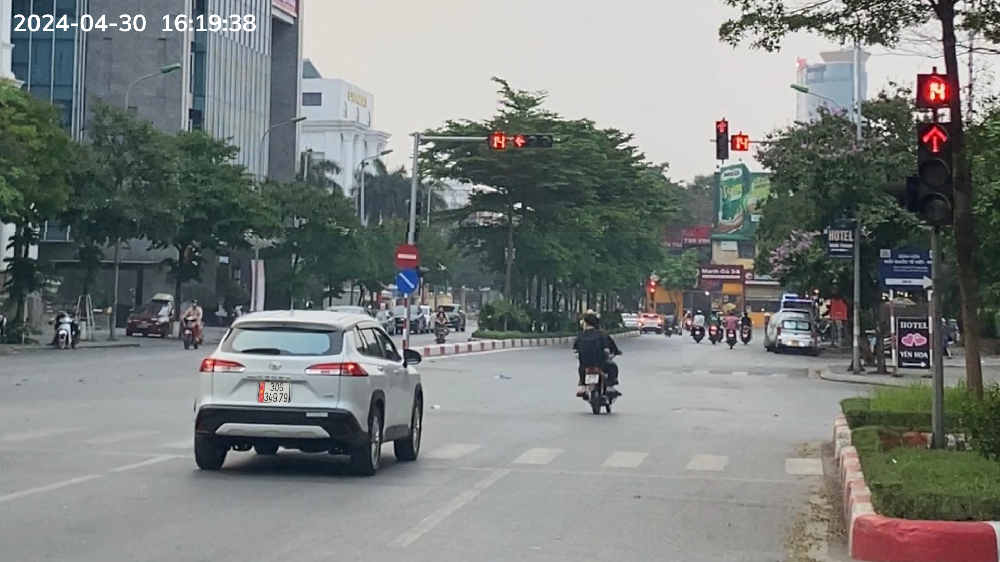

In [ ]:
cv2_imshow(img_cv)

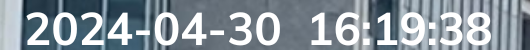

In [ ]:
img_cv = cv2.imread(image_paths[0])


# Cropping an image
cropped_image = img_cv[15:65, 0:530]

# Display cropped image
cv2_imshow(cropped_image)

In [ ]:
import re
pattern=r'(\d{4}\-\d{2}\-\d{2}\s\d{2}\:\d{2}\:\d{2})'
# Example of adding any additional options
custom_oem_psm_config = r'--oem 3 --psm 6'
def extract_text(file_path):
  img_cv = cv2.imread(file_path)
  # Cropping an image
  cropped_image = img_cv[15:65, 0:530]
  text=pytesseract.image_to_string(cropped_image, config=custom_oem_psm_config, lang = 'eng')
  print(text)
  if match := re.search(pattern, text, re.IGNORECASE):
    time_str = match.group(1)
  else:
    time_str = ''
  return time_str

In [ ]:
import pandas as pd

In [ ]:
pd.DataFrame({'FILE': image_paths})\
  .assign(TIME=lambda df: df['FILE'].apply(extract_text))

32024-04-30 16:19:39)|)

024-0430 16:28:08!)

| 2024!/04-30 16:20:112)'*

| 2024!04-30 16:2843'<

t oXayy Wm ec lo es a3: 241 0s 11h

"2024-0430 16:29:02)||)

2024-04-30 116:36:06—

52024-04-30 16:30:37)1('

UA IY clos Kasstede jar oii

2024:-04-30 16:34:25“

2024-04-30 16:34:56)!

12024404-30 16:34h0/0))

2024-04-30 16-35:48<

19024-0430 16:30:31!!!)

92024-04-30 16:3 1/04!)||

| PXOy oy clos Ks e}":)22 0)iIh

92024-04-30 16:3 1:19)|!)

"2024-0430 16:29:04!

Lay iey-maclome cw (i)sritsii hs

12024/04-30 16-42:10/5

§2024104-30 16:40:54)\<

PL Blay acto sit 0 eho }ih

L XUV IV eco sll Pit

| 2024!04-30 16:40n25)—

2024104-30 16:37:44)\<

2024+04-30 16:4044u

Oy ey. mac lowe sty ti leith Hh

2024-04-30 116:36:34)=

PLO Wey. mac lo le sty lpi Is

WX 0). Woy. asco ime A fae; 32 ar It S|

Wyre close we Ill

2024104-30 16:40:18



,FILE,TIME
0,2.png,2024-04-30 16:19:39
1,4.png,
2,3.png,
3,5.png,
4,1.png,
5,6.png,
6,18.png,
7,13.png,2024-04-30 16:30:37
8,14.png,
9,12.png,
